In [1]:
%cd ..

d:\HUST\20232\ML\Project_OCR\HandwritingRecognition


In [2]:
import os
import zipfile
import shutil

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image

from utils import utils
from torchvision.transforms import ToTensor


c:\Users\tandat17z\anaconda3\envs\env_tandat17z\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Split data

In [3]:
root = 'data/dataOCR/'

In [4]:
count_char = []
list_char = set()
for path in os.listdir(root + 'img/'):
    imgpath = root +  'img/' + path
    labelpath = root + 'label/' +  os.path.splitext(path)[0] + '.txt'

    with open(labelpath, 'r') as f:
        content = f.readline().rstrip('\n').strip()
        count_char.append(len(content))
        list_char.update(content)


2001


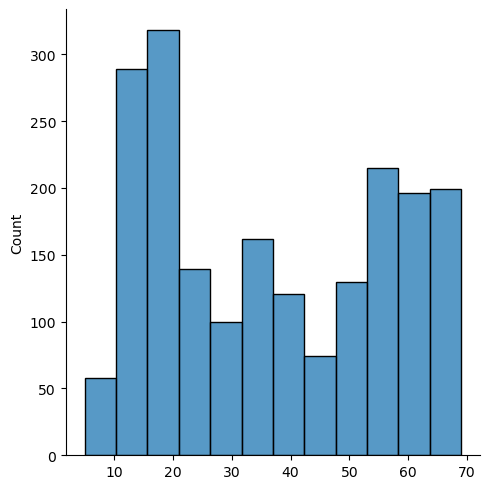

In [5]:
print(len(count_char))
sns.displot(count_char)

In [6]:
l = list(list_char)
l.sort()
char_v3 = ''.join(l)
char_v3

' !"#&(),-./0123456789:?ABCDEFGHIJKLMNOPQRSTUVXYabcdeghiklmnopqrstuvwxyzÀÁÂÔàáâãèéêìíòóôõùúýăĐđĩũơưạẢảẤấầẩẫậắằẳẵặẹẻẽếỀềỂểễỆệỉịọỏốồỔổỗộớờởỡợụỦủỨứừửữựỳỵỷỹ'

In [7]:
root = 'data/dataOCR'
os.makedirs(root + '/train/img')
os.makedirs(root + '/train/label')

os.makedirs(root + '/test/img')
os.makedirs(root + '/test/label')

In [8]:
from sklearn.model_selection import train_test_split

train_data = []
test_data = []
train_data, test_data = train_test_split(os.listdir(root + '/img'), test_size = 0.2, random_state=42)

In [9]:
len(train_data), len(test_data)

(1600, 401)

In [10]:
for path in train_data:
    if path not in os.listdir(root + '/train/img'):
        imgpath = 'data/dataOCR/img/' + path
        labelpath = 'data/dataOCR/label/' + os.path.splitext(path)[0] + '.txt'

        shutil.move(imgpath, root + '/train/img') # Di chuyển file 
        shutil.move(labelpath, root + '/train/label') # Di chuyển file 

In [11]:
for path in test_data:
    if path not in os.listdir(root + '/test/img'):
        imgpath = 'data/dataOCR/img/' + path
        labelpath = 'data/dataOCR/label/' + os.path.splitext(path)[0] + '.txt'

        shutil.move(imgpath, root + '/test/img') # Di chuyển file 
        shutil.move(labelpath, root + '/test/label') # Di chuyển file 

# Check img + label

In [8]:

def img_loader(path, imgH = 32, imgW = 512, threshold = 30):
    img = Image.open(path).convert('L')
    img = img.point(lambda p: 255 - p if 255-p > threshold else 0) # chuyển background về màu đen 0

    img = cropImg(img)

    # Resize hình ảnh + thêm padding (nếu cần)
    desired_w, desired_h = imgW, imgH #(width, height)
    img_w, img_h = img.size  # old_size[0] is in (width, height) format
    ratio = 1.0*img_w/img_h
    new_w = int(desired_h*ratio)
    new_w = min(desired_w, new_w)
    img = img.resize((new_w, desired_h), Image.Resampling.LANCZOS)

    # padding image
    if desired_w != None and desired_w > new_w:
        new_img = Image.new("L", (desired_w, desired_h), color=0)
        new_img.paste(img, (int((desired_w - new_w) / 2), 0))
        img = new_img
    # img = np.array(img)
    # return torch.from_numpy(img)
    # img = img.resize((self.imgW, self.imgH), Image.Resampling.LANCZOS)
    return ToTensor()(img)


def cropImg(img):
    # Cắt bỏ khoảng trống bị thừa xung quanh
    img_array = np.array(img)

    non_empty_columns = np.where(img_array.max(axis=0) > 0)[0]
    non_empty_rows = np.where(img_array.max(axis=1) > 0)[0]
    cropped_img = img_array[min(non_empty_rows):max(non_empty_rows) + 1,
                        min(non_empty_columns):max(non_empty_columns) + 1]
    cropped_img = Image.fromarray(cropped_img)
    return cropped_img


In [9]:
root = 'data/dataOCR/'
# len(os.listdir('D:/HUST/20232/ML/dataOCR/img'))
len(os.listdir(root + 'img/'))

2001

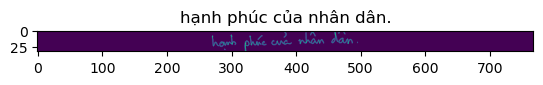

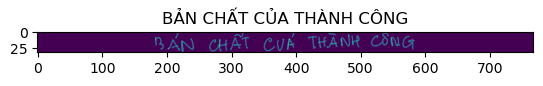

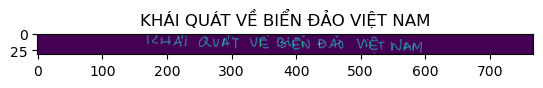

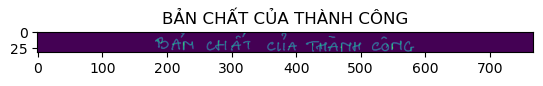

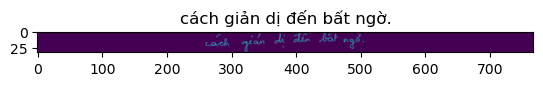

...

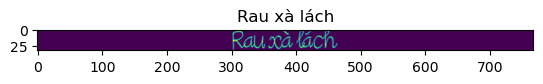

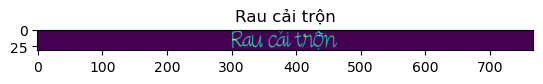

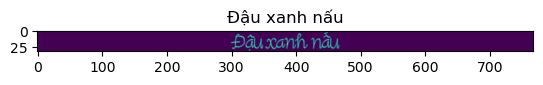

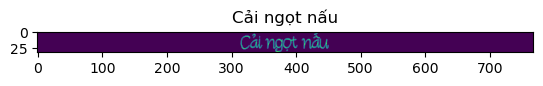

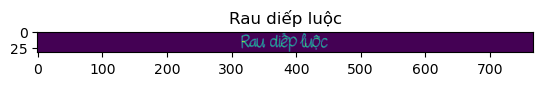

In [12]:
count_char = []
for path in os.listdir(root + 'img/'):
    imgpath = root +  'img/' + path
    labelpath = root + 'label/' +  os.path.splitext(path)[0] + '.txt'

    img = img_loader(imgpath, 32, 768)
    with open(labelpath, 'r') as f:
        content = f.readline().rstrip('\n').strip()
        count_char.append(len(content))
    plt.imshow(img[0])
    plt.title(content)
    plt.show()


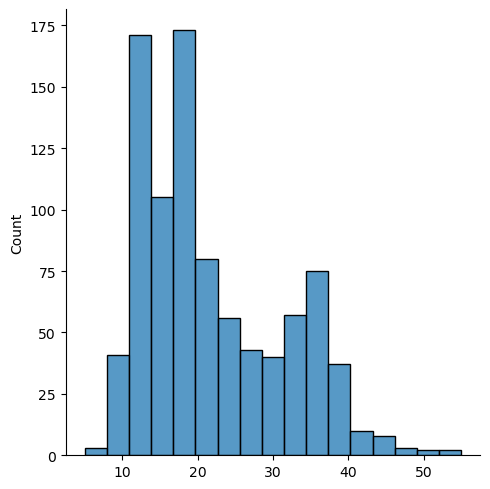

In [19]:
sns.displot(count_char)

In [27]:
!pip install python-docx


   ---------------------------------------- 0.0/244.3 kB ? eta -:--:--
   - -------------------------------------- 10.2/244.3 kB ? eta -:--:--
   ---- ---------------------------------- 30.7/244.3 kB 330.3 kB/s eta 0:00:01
   --------- ----------------------------- 61.4/244.3 kB 469.7 kB/s eta 0:00:01
   --------------------------- ---------- 174.1/244.3 kB 952.6 kB/s eta 0:00:01
   ---------------------------------------- 244.3/244.3 kB 1.3 MB/s eta 0:00:00
   ---------------------------------------- 0.0/3.8 MB ? eta -:--:--
   --- ------------------------------------ 0.3/3.8 MB 6.5 MB/s eta 0:00:01
   ----- ---------------------------------- 0.5/3.8 MB 5.0 MB/s eta 0:00:01
   ------- -------------------------------- 0.7/3.8 MB 5.3 MB/s eta 0:00:01
   ---------- ----------------------------- 1.0/3.8 MB 5.3 MB/s eta 0:00:01
   ------------- -------------------------- 1.3/3.8 MB 5.5 MB/s eta 0:00:01
   --------------- ------------------------ 1.5/3.8 MB 5.2 MB/s eta 0:00:01
   ---------

In [28]:
from docx import Document

# Đọc nội dung từ file .docx
def read_docx(file_path):
    doc = Document(file_path)
    full_text = []
    for para in doc.paragraphs:
        full_text.append(para.text)
    return '\n'.join(full_text)

# Ghi nội dung vào file .txt
def write_to_txt(text, output_path):
    with open(output_path, 'w', encoding='utf-8') as file:
        file.write(text)

# Đường dẫn đến file .docx và file .txt
for path in os.listdir(root + 'label/'):
    input_docx_path = root + 'label/' + path
    output_txt_path = root + 'label/' + os.path.splitext(path)[0] + '.txt'

# Đọc nội dung từ file .docx
docx_content = read_docx(input_docx_path)

# Ghi nội dung vào file .txt
write_to_txt(docx_content, output_txt_path)


PackageNotFoundError: Package not found at 'data/raw/BinhAn_v2/label/~$(1).docx'

# Check dataset

In [3]:
from customDataset import custom_DatasetImg

dataset = custom_DatasetImg('data/dataOCR/img','data/dataOCR/label')

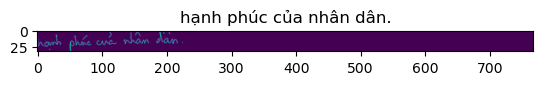

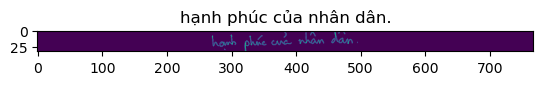

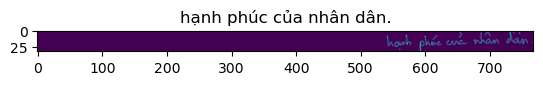

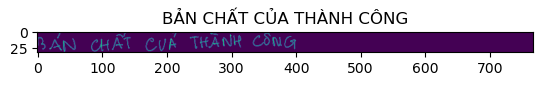

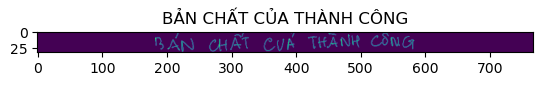

...

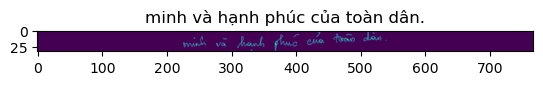

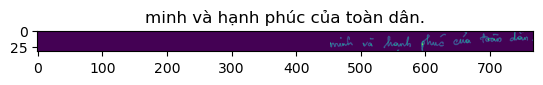

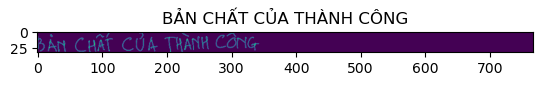

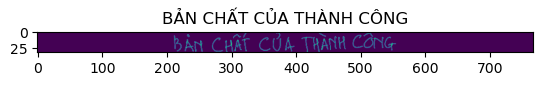

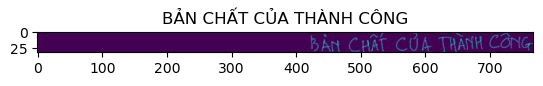

In [5]:
for i in range(10):
    for x in [0 + i, 2001 + i, 4002 + i]:
        img, label = dataset[x]
        plt.imshow(img[0])
        plt.title(label)
        plt.show()